# Album Artwork Generator
This is a notebook for using Stable Diffusion Hugging Face (HF) Pipelines to generate and manipulate album artwork for musicians.

As a musician, I often have ideas for artwork that I want to release with my music, but I lack the time and experience to be able to achieve my vision. And as a hobbyist, I don't always have the financial resources to hire a professional to help me in this endeavor. With the advent and open-sourcing of [Stable Diffusion](https://stability.ai/stablediffusion) (among other generative models), it is now possible to generate incredible artwork from a basic text prompt and perform other image manipulations not previously possible.

[HF Diffuser Pipelines](https://huggingface.co/docs/diffusers/index) offer an easy way to utilize various Stable Diffusion models for inference with little code.

This notebook consists of the following functionalities:
|Function|Resolution (px)|Description|
|---|---|---|
|Text to Image Generation|768x768|Generate images from a text prompt|
|Upscale Images|512x512 --> 2048x2048|Upscale images to increase resolution (upscaling higher resolution images requires more GPU VRAM)|
|Stepped Image Generation|768x768|Visualize various steps of the diffusion process|
|Image to Image Generation|768x768|Generate images from a text prompt and condition on an input image|
|Image Resizing Utility (no diffusion)|Any|Simple image resizing utility that does not affect the resolution of the image|

Some of this code was adapted from [Practical Deep Learning For Coders](https://course.fast.ai/) (Jeremy Howard @ fast.ai).

### Setup
**Requirements**
- CUDA-capable GPU with minimum 16GB VRAM, [CUDA toolkit](https://developer.nvidia.com/cuda-toolkit) installed
- Linux OS (Ubuntu used in steps below)
- [Anaconda](https://www.anaconda.com/) or [Miniconda](https://docs.conda.io/en/latest/miniconda.html)

**Option 1 (recommended): Create Environment**
See [README](README.md) for environment setup instructions.

**Option 2: Install From Notebook**
Provided that the requirements are met, uncomment and run the following cell to install pip dependencies.

In [1]:
# !pip install -r requirements.txt

#### Hugging Face Login
To use models, the model licenses must be accepted via Hugging Face.

In [2]:
from pathlib import Path
from huggingface_hub import notebook_login
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

### Imports & Functions

In [3]:
from PIL import Image
import matplotlib.pyplot as plt
import torch

# Stable Diffusion Pipelines
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler,\
                       DPMSolverMultistepScheduler, StableDiffusionUpscalePipeline,\
                       StableDiffusionImg2ImgPipeline

In [4]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

## Text To Image Generation
Generate an image from text.

In [97]:
### USER INPUT ###
prompt = "a happy cute golden doodle puppy sitting on a dog bed with a ball" # Image prompt
negative_prompt = "" # optional negative prompt
num_images = 3 # Number of images to generate
num_inference_steps = 100 # Number of inference steps
save_image_name = "puppies" # Filename of image to be saved
manual_seed = 1024 # Set manual seed (for repeatability). False for random output.

  0%|          | 0/50 [00:00<?, ?it/s]

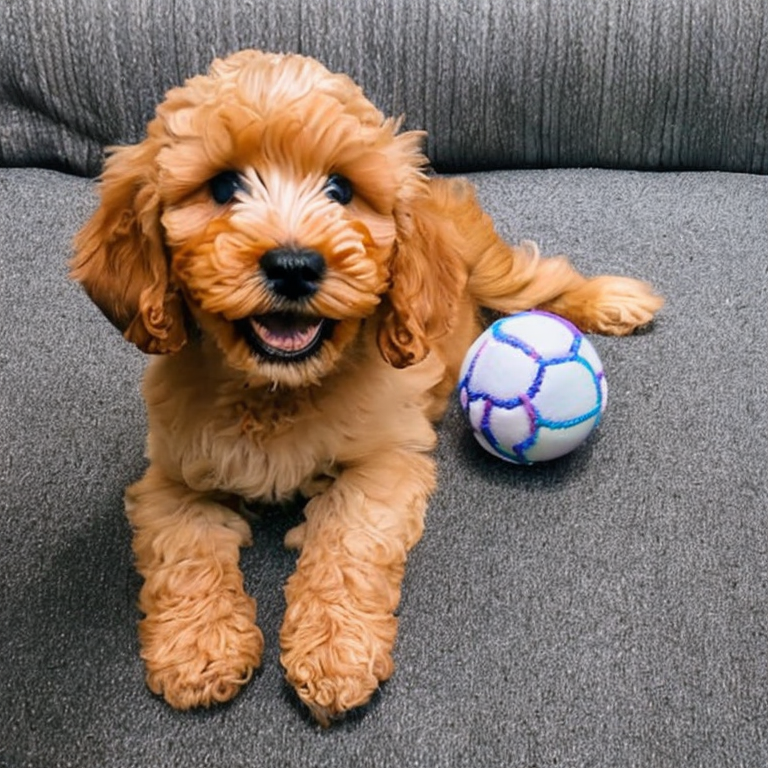

In [98]:
# Model ID
model_id = "stabilityai/stable-diffusion-2-1" # Stable Diffusion 2.1

# SCHEDULER OPTIONS
# DPMSolverMultistepScheduler (DPM-Solver++) scheduler
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

# # Euler scheduler (uncomment to use Euler scheduler instead)
# scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
# pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, torch_dtype=torch.float16)

# Assign pipline to GPU
pipe = pipe.to("cuda")

# Set seed
if manual_seed:
    torch.manual_seed(manual_seed)
    
# Generate image

images = pipe(prompt=prompt, num_images_per_prompt=num_images, negative_prompt=negative_prompt, num_inference_steps=num_inference_steps).images[0]
# image.save(f"{save_image_name}_768x768.png") # save 768x768 image
# image.show() # display image
image_grid(images, rows=1, cols=num_images).show()

# Save images
for i, im in enumerate(images):
    im.save(f"{save_image_name}_ver{i}_768x768.png")
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## 4x Upscaler
Upscale images by 4x. The upscaler requires a significant amount of CUDA memory, therefore only 512x512 (or lower) images can be upscaled to 2048x2048. Higher resolution images can be upscaled, but it will require >16GB VRAM.

In [99]:
### USER INPUT ###
image_path = 'puppies_768x768.png' # Specify the file path of the image
prompt = prompt # Image prompt (optional) - Add additional image prompt
image_dim = 512 # define image to be resized to (only if larger than this dim) - image_dim cannot exceed 512 to run on <16GB VRAM

  0%|          | 0/75 [00:00<?, ?it/s]

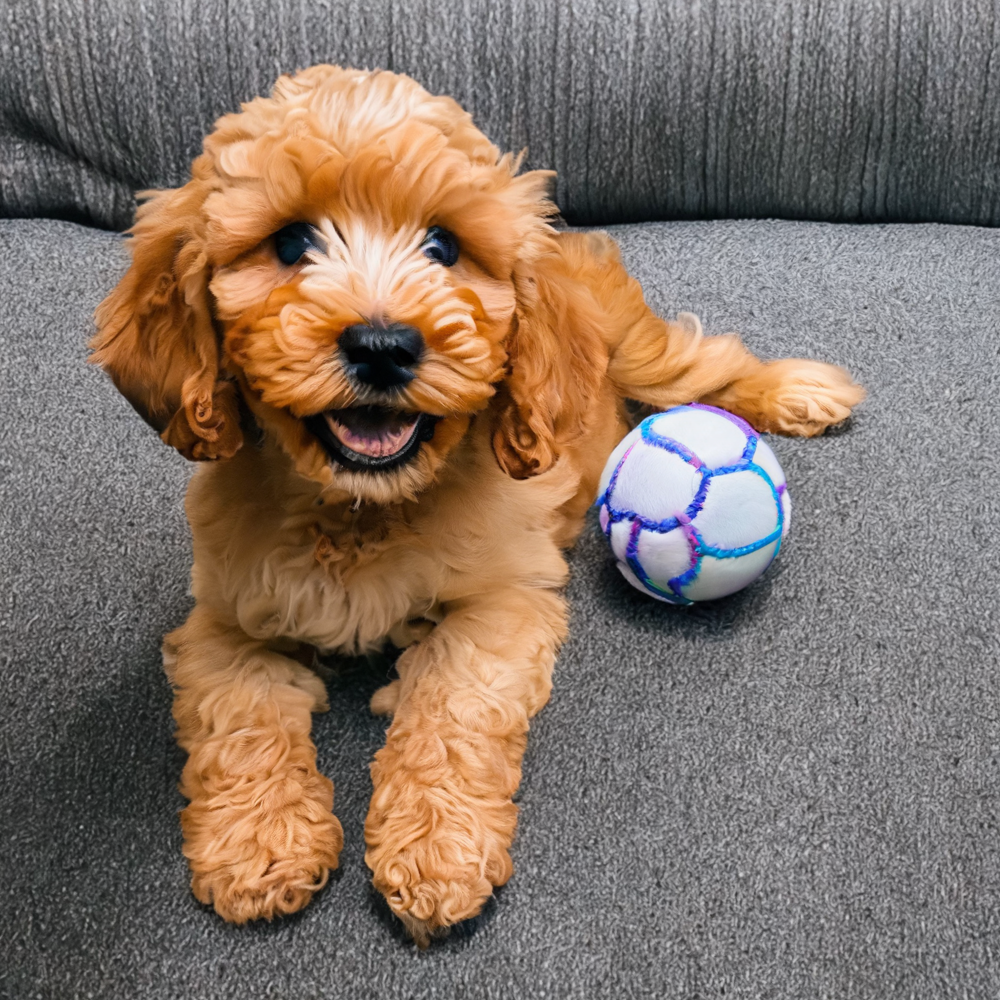

In [100]:
# Open the image
image = Image.open(image_path)

# Resize image if too large
if image.size[0] > image_dim or image.size[0] > image_dim:
    image = image.resize((image_dim, image_dim))

# # Display information about the input image
# print("Image format:", image.format)
# print("Image size:", image.size)
# print("Image mode:", image.mode)

# Upscale image
# load model and scheduler
model_id = "stabilityai/stable-diffusion-x4-upscaler"
pipe = StableDiffusionUpscalePipeline.from_pretrained(model_id, torch_dtype=torch.float16).to("cuda")
pipe.enable_attention_slicing() # improves memory usage

# set seed
if manual_seed:
    torch.manual_seed(manual_seed)

# Adjust for memory and upsample
pipe.set_use_memory_efficient_attention_xformers(True) # required to fit on 16GB VRAM
upscaled_image = pipe(prompt=prompt, image=image).images[0]
upscaled_image.save(f"{save_image_name}_2048x2048.png")
upscaled_image.show()
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Image to Image
Provide and input image to generate something similar.

In [54]:
### USER INPUT ###
prompt = "intricate and detailed romantic painting of a person playing guitar on stage in front of an audience on a sunny day" # Image prompt
in_image_path = './examples/img2img_pre.png' # Specify the file path of the input image
save_image_name = "img2img_post" # Filename of image to be saved
num_images = 3 # Number of images to generate
strength = 0.9 # Amount of noise added to ini image (0.8 is usually a good starting point)
num_inference_steps = 100 # Number of inference steps

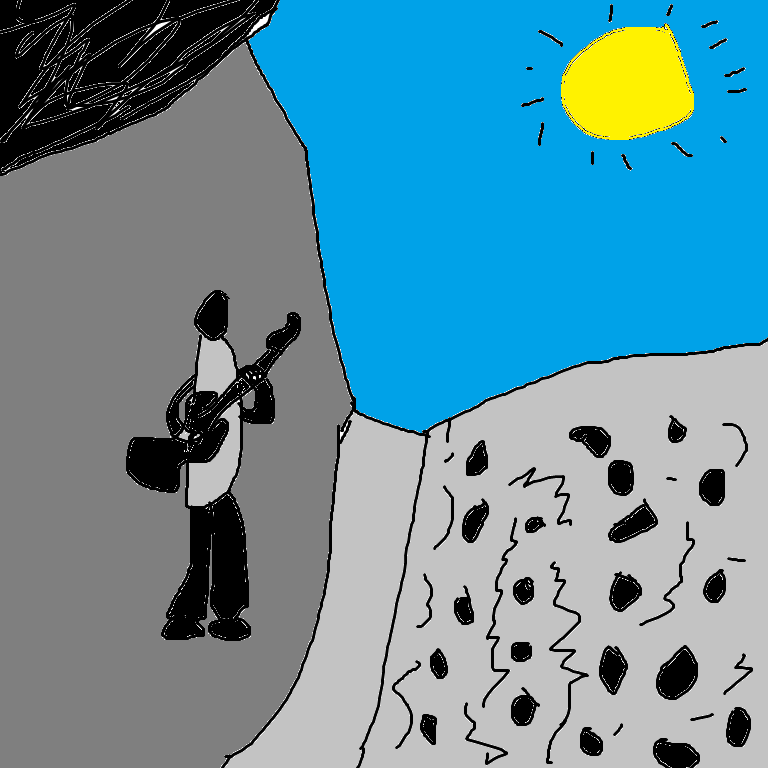

  0%|          | 0/90 [00:00<?, ?it/s]

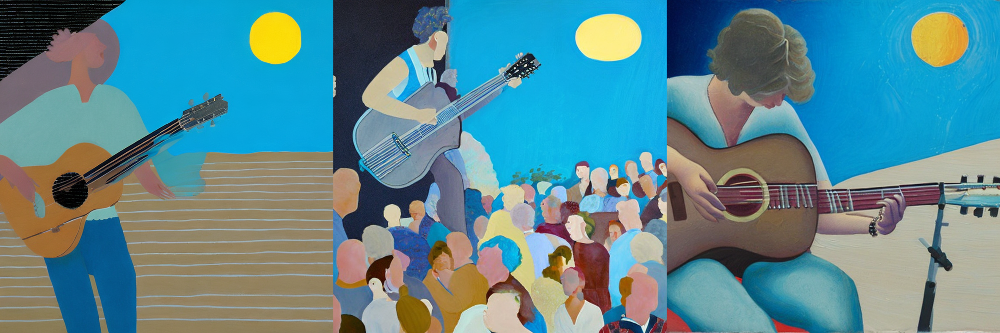

In [55]:
# Reassign pipeline object
pipe = StableDiffusionImg2ImgPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16).to("cuda")

# Open the input image
init_image = Image.open(in_image_path).convert("RGB") # convert to RGB if not already
init_image.show() # uncomment to show init image

# Generate images
if manual_seed:
    torch.manual_seed(manual_seed)
images = pipe(prompt=prompt, num_images_per_prompt=num_images, image=init_image, strength=strength, num_inference_steps=num_inference_steps).images
image_grid(images, rows=1, cols=num_images).show()

# Save images
for i, im in enumerate(images):
    im.save(f"{save_image_name}_ver{i}.png")
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Stepped Images
Generate steps in the diffusion process

In [83]:
### USER INPUT ###
prompt = "a golden doodle puppy sitting on a dog bed with a tennis ball" # Image prompt
num_inference_steps = 50 # Number of inference steps (default: 50)
callback_steps = 15 # diffusion step interval at which to generate image

  0%|          | 0/50 [00:00<?, ?it/s]

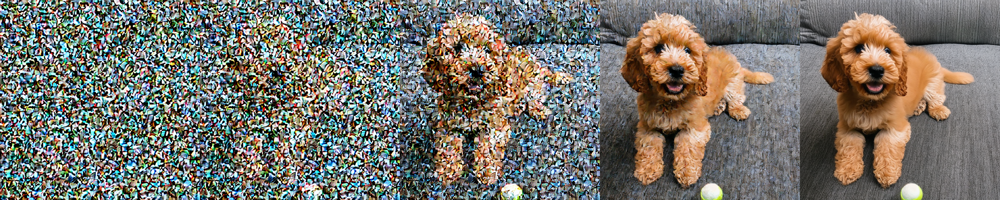

In [84]:
# Reassign pipeline object
pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16).to("cuda")

# code modified from fast.ai
vae = pipe.vae # instntiate vae object
images = [] # initialize images

def latents_callback(i, t, latents):
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample[0]
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))

# Generate images
if manual_seed:
    torch.manual_seed(manual_seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=callback_steps, num_inference_steps=num_inference_steps).images[0]
images.append(final_image)
image_grid(images, rows=1, cols=len(images)).show()
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Resize Image Utility
Simple Python utility to resize image to any resolution.
This does not involve diffusion, therefore upsampling here does not improve quality.

In [13]:
### USER INPUT ###
in_image_path = 'mountains4_2048x2048.png' # Specify the file path of the input image
image_dim = 3072 # square image (image_dim x image_dim)
save_image_path = 'mountains4_3072x3072.png' # Path to save image to

In [14]:
# Open the input image using Pillow
in_image = Image.open(in_image_path)

# Upsample the image to the desired size (image_dim x image_dim)
save_image = in_image.resize((image_dim, image_dim))

# Save the upsampled image to a new file
save_image.save(save_image_path)

# Close the image files
in_image.close()
save_image.close()